In [3]:
from torchdiffeq import odeint_adjoint as odeint
%load_ext autoreload
%autoreload 2

In [4]:
import pickle
import pprint
import torch
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import TensorDataset, DataLoader
import torchviz
import einops
torch.cuda.is_available()

True

In [5]:
import math
import numpy as np
from IPython.display import clear_output
from tqdm import tqdm_notebook as tqdm

import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.color_palette("bright")
import matplotlib as mpl
import matplotlib.cm as cm

import torch
from torch import Tensor
from torch import nn
from torch.nn import functional as F 
from torch.autograd import Variable

from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split


use_cuda = torch.cuda.is_available()
device = 'cuda' if torch.cuda.is_available() else 'cpu' 

In [6]:
import pandas as pd
import scipy

In [7]:
sweep_config = {
    'method': 'random'
    }
    
metric = {
    'name': 'val_loss',
    'goal': 'minimize'   
    }

sweep_config['metric'] = metric    

In [8]:
parameters_dict = {
    # dataset params
    'dataset_type': {'value': 'experimental_saved'}, 
    # fixed params
    'optimizer': {'value': 'adam'},
    # architecture params
    'arch_in_dim' : {'value': 2},
    'arch_hid_dim' : {'values': [2, 8, 32]},
    # learning params
    'epochs' : {'values': [500, 1000, 2000]},
    'early_stop_epochs' : {'value' : 100},
    'batch_size' : {'value': 64},
    'learning_rate' : {'value': 0.01},
    # neural ODE specific params
    'solver_type' : {'values' : ['euler', 'rk4', 'dopri5', 'bosh3']},
    'time_idependent_num_ts' : {'values' : [2, 10, 20]},
    'return_whole_sequence' : {'value' : False},

    # 'fc_layer_size': {
    #     'values': [128, 256, 512]
    #     },
    # 'dropout': {
    #       'values': [0.3, 0.4, 0.5]
    #     },
    }

sweep_config['parameters'] = parameters_dict

pprint.pprint(sweep_config)

{'method': 'random',
 'metric': {'goal': 'minimize', 'name': 'val_loss'},
 'parameters': {'arch_hid_dim': {'values': [2, 8, 32]},
                'arch_in_dim': {'value': 2},
                'batch_size': {'value': 64},
                'dataset_type': {'value': 'experimental_saved'},
                'early_stop_epochs': {'value': 100},
                'epochs': {'values': [500, 1000, 2000]},
                'learning_rate': {'value': 0.01},
                'optimizer': {'value': 'adam'},
                'return_whole_sequence': {'value': False},
                'solver_type': {'values': ['euler', 'rk4', 'dopri5', 'bosh3']},
                'time_idependent_num_ts': {'values': [2, 10, 20]}}}


Adaptive-step:
- dopri8 Runge-Kutta 7(8) of Dormand-Prince-Shampine
- dopri5 Runge-Kutta 4(5) of Dormand-Prince [default].
- bosh3 Runge-Kutta 2(3) of Bogacki-Shampine
- adaptive_heun Runge-Kutta 1(2)

Fixed-step:
- euler Euler method.
- midpoint Midpoint method.
- rk4 Fourth-order Runge-Kutta with 3/8 rule.
- explicit_adams Explicit Adams.
- implicit_adams Implicit Adams.

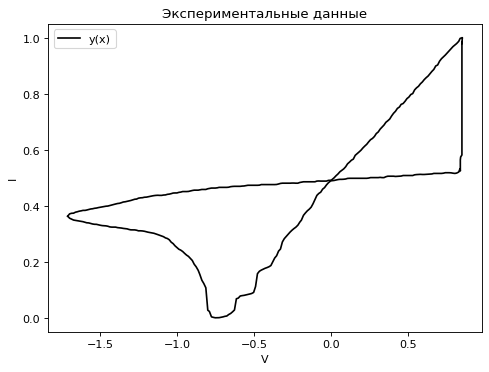

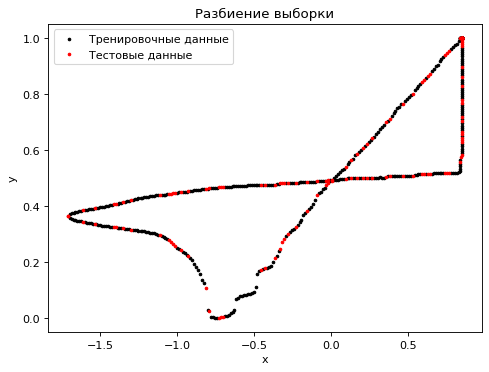

In [9]:
from data_utils import load_existing_experimental_dataset, viz_existing_experimental_dataset
_ = load_existing_experimental_dataset()
_ = viz_existing_experimental_dataset()

In [10]:
# config.dataset_type
from data_utils import load_existing_hyst_dataset, create_hyst_dataset, load_existing_experimental_dataset, viz_existing_experimental_dataset
from models import ODEFunc
from tqdm.notebook import tqdm



criterion = torch.nn.functional.mse_loss

def train(project='experimental-neuralODE-sweep', config=None):
    # Initialize a new wandb run
    with wandb.init(config=config):
        # If called by wandb.agent, as below,
        # this config will be set by Sweep Controller
        config = wandb.config
        
        trainloader, testloader, full_X, full_y, no_noise_y = build_dataset(config.dataset_type, config.batch_size)
        
        network = build_network(config.arch_in_dim, config.arch_hid_dim)
        optimizer = build_optimizer(network, config.optimizer, config.learning_rate)
        train_epochs(model=network,
                      train_loader=trainloader,
                       test_loader=testloader,
                         criterion=criterion,
                           optimizer=optimizer,  
                           full_X=full_X,
                             full_y=full_y,
                            viz_data=no_noise_y, 
                             config=config)
 
def build_dataset(which, batch_size):
    """
    which: 'hyst', 'hyst_saved', 'experimental', 'experimental_saved'
    """
    if which=='hyst':
        train_dataset, test_dataset, X_full, y_full, no_noise_y  = create_hyst_dataset()
    elif which=='hyst_saved':
        train_dataset, test_dataset, X_full, y_full, no_noise_y = load_existing_hyst_dataset()
    elif which == 'experimental_saved':
        train_dataset, test_dataset, X_full, y_full, no_noise_y = load_existing_experimental_dataset()    

    trainloader = torch.utils.data.DataLoader(
                  train_dataset, 
                  batch_size=batch_size)
    testloader = torch.utils.data.DataLoader(
                    test_dataset,
                    batch_size=batch_size)

    return trainloader, testloader, X_full, y_full, no_noise_y


def build_network(in_dim, hid_dim):
    network = ODEFunc(in_dim=in_dim, hid_dim=hid_dim)

    return network.to(device)
        

def build_optimizer(network, optimizer, learning_rate):
    if optimizer == "sgd":
        optimizer = torch.optim.SGD(network.parameters(),
                              lr=learning_rate, momentum=0.9)
    elif optimizer == "adam":
        optimizer = torch.optim.Adam(network.parameters(),
                               lr=learning_rate)
    return optimizer


def train_epochs(model, train_loader, test_loader, criterion, optimizer, full_X, full_y, viz_data, config):
        # Tell wandb to watch what the model gets up to: gradients, weights, and more!
    """
    includes:
    learning for n epochs
    logging train loss every epoch
    testing on val_set every epoch
    logging test loss every epoch

    saving weights for best epoch
    logging visualisation to wandb for best epoch

    """

    wandb.watch(model, criterion, log="all", log_freq=10)

    # time to input to odeint
    t = torch.linspace(0, 1, config.time_idependent_num_ts).to(device)
    # Run training and track with wandb
    total_batches = len(train_loader) * config.epochs
    example_ct = 0  # number of examples seen
    batch_ct = 0
    min_val_loss = 1000
    val_loss = min_val_loss
    no_better_counter = 0 
    for epoch in tqdm(range(config.epochs)):
        for _, (x, y) in enumerate(train_loader):

            loss = train_batch_ode(x, y, t, model, optimizer, criterion, config)
            example_ct +=  len(x)
            batch_ct += 1

            # Report metrics every 25th batch
            if ((batch_ct + 1) % 25) == 0:
                print(f'logging: {epoch=}, {example_ct=}, {loss=}, {val_loss=}, {min_val_loss=}')
                wandb.log({"epoch": epoch, "train_mse": loss}, step=example_ct)
        no_better_counter += 1         
        
        if (epoch + 1) % 25 == 0:
            with torch.no_grad():
                val_loss = test_log_vis(model,
                                         t,
                                           test_loader,
                                            train_loader,
                                             epoch,
                                               example_ct,
                                                min_val_loss,
                                                full_X, full_y, viz_data,
                                                  config)
                if val_loss < min_val_loss:
                    min_val_loss = val_loss
                    no_better_counter = 0 

        if no_better_counter > config.early_stop_epochs:
            print(f'Early stopping: {no_better_counter=}')
            break

def train_batch_ode(x, y, t, model, optimizer, criterion, config): 
    optimizer.zero_grad()
    x, y = x.to(device), y.to(device)
        
    # Forward pass ➡
    pred_y = odeint(model, y0=x, t=t, method=config.solver_type, adjoint_method=config.solver_type).to(device)
    if not config.return_whole_sequence:
        pred_y=pred_y[-1]
        
    loss = criterion(pred_y, y)
    
    # Backward pass ⬅
    loss.backward()

    # Step with optimizer
    optimizer.step()
    return loss

def test_log_vis(model, t, test_loader, train_loader, epoch, example_ct, min_val_loss, full_X, full_y, viz_data, config):
    with torch.no_grad():
        val_loss = 0 

        # X_test = []
        # y_test = []
        t.to(device)
        for _, (x, y) in enumerate(test_loader): 
            x, y = x.to(device), y.to(device)

            pred_y = odeint(model, t=t, y0=x, method=config.solver_type, adjoint_method=config.solver_type).to(device)
            if not config.return_whole_sequence:
                pred_y=pred_y[-1]
            loss = criterion(pred_y, y)
            val_loss+=loss

            # X_test.append(x)
            # y_test.append(y)

        val_loss /= len(test_loader)
        val_loss = val_loss.item()   
        print(f'testing: {val_loss=}') 

        wandb.log({"epoch": epoch, "test_mse": val_loss}, step=example_ct) 
        # visualising:
        if val_loss < min_val_loss: 
            """ X_train y_train X_test y_test X_full, y_full"""
            # X_train = []
            # y_train = []
           
            # X_train = torch.cat(X_train, dim=0)
            # X_test = torch.cat(X_test, dim=0)
            # y_train = torch.cat(y_train, dim=0)
            # y_test = torch.cat(y_test, dim=0)
            X_train, X_test, y_train, y_test = viz_data
            full_X = torch.Tensor(full_X).to(device)




            z_full = odeint(model, t=t.to(device), y0=full_X.to(device), method=config.solver_type, adjoint_method=config.solver_type).to(device)
            if not config.return_whole_sequence:
                z_full=z_full[-1].cpu()
            full_X=full_X.cpu()
            # X_train=X_train.cpu()
            # X_test=X_test.cpu()
            # y_train = y_train.cpu()
            # y_test = y_test.cpu()

            plt.close()
            plt.figure(figsize=(10, 7), dpi=100)
            sc_1 = plt.scatter(X_train[:, 0], y_train[:, 0], color = 'black', s=5, label = 'Тренировочные данные')
            plt.scatter(X_train[:, 0], y_train[:, 1], color = 'black', s=5)
            sc_2 = plt.scatter(X_test[:, 0], y_test[:, 0], color = 'red', s=5, label = 'Тестовые данные')
            plt.scatter(X_test[:, 0], y_test[:, 1], color = 'red', s=5)
            plt.plot(full_X[:, 0], z_full[:, 0], color = 'green', label = 'Аппроксимация')
            plt.plot(full_X[:, 0], z_full[:, 1], color = 'green')
            
            # t = np.linspace(-3*np.pi/4, np.pi/4, 100, endpoint = True)
            # plt.plot(t, np.sin(t), color = 'pink', label = 'Незашумленные данные')
            # plt.plot(t, np.cos(t), color = 'pink')
            plt.legend()
            plt.xlabel('x')
            plt.ylabel('y')
            plt.title('Результат ') 
        
            wandb.log({"Result": wandb.Image(plt), 'epoch': epoch}, step=example_ct)
        return val_loss               

In [11]:
device

'cuda'

In [12]:
parameters_dict

{'dataset_type': {'value': 'experimental_saved'},
 'optimizer': {'value': 'adam'},
 'arch_in_dim': {'value': 2},
 'arch_hid_dim': {'values': [2, 8, 32]},
 'epochs': {'values': [500, 1000, 2000]},
 'early_stop_epochs': {'value': 100},
 'batch_size': {'value': 64},
 'learning_rate': {'value': 0.01},
 'solver_type': {'values': ['euler', 'rk4', 'dopri5', 'bosh3']},
 'time_idependent_num_ts': {'values': [2, 10, 20]},
 'return_whole_sequence': {'value': False}}

In [13]:
sweep_id = wandb.sweep(sweep_config, project="pytorch-sweeps-experimental")

Create sweep with ID: crerrh88
Sweep URL: https://wandb.ai/peter_chizhov/pytorch-sweeps-experimental/sweeps/crerrh88


wandb: Agent Starting Run: ujkf0tsx with config:
wandb: 	arch_hid_dim: 32
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 2000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: dopri5
wandb: 	time_idependent_num_ts: 20
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/2000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.0388, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0222, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0192, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0224, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0193, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.020636819303035736, min_val_loss=0.020636819303035736
logging: epoch=37, example_ct=7501, loss=tensor(0.0221, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.020636819303035736, min_val_loss=0.020636819303035736
logging: epoch=43, example_ct=8771, loss=tensor(0.0186, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.02063681930303

C:\Users\Peter Chizhov\AppData\Local\Temp\ipykernel_17760\63271784.py:192: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 7), dpi=100)


logging: epoch=530, example_ct=106731, loss=tensor(0.0013, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.004256170243024826, min_val_loss=0.004256170243024826
logging: epoch=537, example_ct=108001, loss=tensor(0.0071, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.004256170243024826, min_val_loss=0.004256170243024826
logging: epoch=543, example_ct=109271, loss=tensor(0.0044, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.004256170243024826, min_val_loss=0.004256170243024826
logging: epoch=549, example_ct=110541, loss=tensor(0.0037, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.004256170243024826, min_val_loss=0.004256170243024826
logging: epoch=555, example_ct=111756, loss=tensor(0.0011, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.004121229983866215, min_val_loss=0.004121229983866215
logging: epoch=562, example_ct=113026, loss=tensor(0.0069, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.004121229983866215, min_val_loss=0

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
test_mse,██▇▃▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁▁
train_mse,███▅▂▃▂▃▂▃▂▃▂▃▂▃▁▂▁▂▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁▂▁
epoch,1449
test_mse,0.00263
train_mse,0.00227


wandb: Agent Starting Run: c62xzmut with config:
wandb: 	arch_hid_dim: 8
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 500
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: dopri5
wandb: 	time_idependent_num_ts: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/500 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.1012, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0323, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0231, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0240, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0202, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.02190149389207363, min_val_loss=0.02190149389207363
logging: epoch=37, example_ct=7501, loss=tensor(0.0222, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.02190149389207363, min_val_loss=0.02190149389207363
logging: epoch=43, example_ct=8771, loss=tensor(0.0190, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.02190149389207363,

epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
test_mse,██▇▇▅▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁
train_mse,█▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,499
test_mse,0.00347
train_mse,0.00317


wandb: Agent Starting Run: xwovt2sd with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 2000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: dopri5
wandb: 	time_idependent_num_ts: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/2000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.3217, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.1409, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0732, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0442, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0261, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.03664354234933853, min_val_loss=0.03664354234933853
logging: epoch=37, example_ct=7501, loss=tensor(0.0224, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.03664354234933853, min_val_loss=0.03664354234933853
logging: epoch=43, example_ct=8771, loss=tensor(0.0192, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.03664354234933853,

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
test_mse,█▄▄▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse,█▄▄▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,1999
test_mse,0.00309
train_mse,0.00286


wandb: Agent Starting Run: 5qsw3rfx with config:
wandb: 	arch_hid_dim: 8
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 500
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: bosh3
wandb: 	time_idependent_num_ts: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/500 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.1001, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0376, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0255, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0250, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0208, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.022783789783716202, min_val_loss=0.022783789783716202
logging: epoch=37, example_ct=7501, loss=tensor(0.0219, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.022783789783716202, min_val_loss=0.022783789783716202
logging: epoch=43, example_ct=8771, loss=tensor(0.0188, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.02278378978371

epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
test_mse,█▇▇▆▅▃▂▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse,█▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,499
test_mse,0.0043
train_mse,0.00392


wandb: Sweep Agent: Waiting for job.
wandb: Job received.
wandb: Agent Starting Run: qro6btt8 with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 2000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: dopri5
wandb: 	time_idependent_num_ts: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/2000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.2881, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.1254, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0646, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0472, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0298, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.039116933941841125, min_val_loss=0.039116933941841125
logging: epoch=37, example_ct=7501, loss=tensor(0.0239, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.039116933941841125, min_val_loss=0.039116933941841125
logging: epoch=43, example_ct=8771, loss=tensor(0.0209, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.03911693394184

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
test_mse,█▄▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse,█▄▄▄▃▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,1999
test_mse,0.00317
train_mse,0.00295


wandb: Agent Starting Run: gz2v1jmf with config:
wandb: 	arch_hid_dim: 8
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: euler
wandb: 	time_idependent_num_ts: 20
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/1000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.1467, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0417, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0246, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0238, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0199, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.021871201694011688, min_val_loss=0.021871201694011688
logging: epoch=37, example_ct=7501, loss=tensor(0.0219, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.021871201694011688, min_val_loss=0.021871201694011688
logging: epoch=43, example_ct=8771, loss=tensor(0.0185, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.02187120169401

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
test_mse,█▇▇▅▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse,█▄▄▄▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
epoch,999
test_mse,0.00292
train_mse,0.00268


wandb: Agent Starting Run: vds7chqd with config:
wandb: 	arch_hid_dim: 8
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 500
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: bosh3
wandb: 	time_idependent_num_ts: 20
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/500 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.0879, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0307, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0225, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0236, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0199, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.0216357558965683, min_val_loss=0.0216357558965683
logging: epoch=37, example_ct=7501, loss=tensor(0.0219, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.0216357558965683, min_val_loss=0.0216357558965683
logging: epoch=43, example_ct=8771, loss=tensor(0.0187, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.0216357558965683, min_

epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
test_mse,█▇▇▆▄▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
train_mse,█▃▃▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,499
test_mse,0.00374
train_mse,0.00341


wandb: Agent Starting Run: m3991kt8 with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 500
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: euler
wandb: 	time_idependent_num_ts: 10
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/500 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.2948, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.1156, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0565, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0413, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0268, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.034413691610097885, min_val_loss=0.034413691610097885
logging: epoch=37, example_ct=7501, loss=tensor(0.0229, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.034413691610097885, min_val_loss=0.034413691610097885
logging: epoch=43, example_ct=8771, loss=tensor(0.0199, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.03441369161009

epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
test_mse,█▅▄▄▄▄▃▃▂▂▂▁▁▁▁▁▁▁▁▁
train_mse,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,499
test_mse,0.00645
train_mse,0.00609


wandb: Agent Starting Run: z7fvo06a with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 2000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: euler
wandb: 	time_idependent_num_ts: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/2000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.2772, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0989, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0392, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0366, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0395, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.034513138234615326, min_val_loss=0.034513138234615326
logging: epoch=37, example_ct=7501, loss=tensor(0.1280, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.034513138234615326, min_val_loss=0.034513138234615326
logging: epoch=43, example_ct=8771, loss=tensor(0.7041, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.03451313823461

epoch,▁▁▂▂▂▂▃▃▄▄▄▄▅▅▅▅▆▆▇▇▇▇███
test_mse,▁▁▃▅█
train_mse,▁▁▁▁▁▁▁▁▁▂▂▃▃▄▄▅▅▆▇█
epoch,124
test_mse,146.00346
train_mse,150.88553


wandb: Agent Starting Run: hf4ivd0u with config:
wandb: 	arch_hid_dim: 32
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: euler
wandb: 	time_idependent_num_ts: 20
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/1000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.0396, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0234, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0190, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0223, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0191, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.020649710670113564, min_val_loss=0.020649710670113564
logging: epoch=37, example_ct=7501, loss=tensor(0.0222, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.020649710670113564, min_val_loss=0.020649710670113564
logging: epoch=43, example_ct=8771, loss=tensor(0.0186, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.02064971067011

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
test_mse,██▇▅▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse,██▇▆▄▃▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▃▂▂▁
epoch,999
test_mse,0.00312
train_mse,0.00286


wandb: Agent Starting Run: 7na8fbkj with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 500
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: rk4
wandb: 	time_idependent_num_ts: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/500 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.3148, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.1326, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0746, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0500, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0304, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.04128965735435486, min_val_loss=0.04128965735435486
logging: epoch=37, example_ct=7501, loss=tensor(0.0240, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.04128965735435486, min_val_loss=0.04128965735435486
logging: epoch=43, example_ct=8771, loss=tensor(0.0214, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.04128965735435486,

epoch,▁▁▂▂▂▂▂▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇████
test_mse,▁▁▁▁▁█▅
train_mse,▄▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▃█▆▅▅▅
epoch,174
test_mse,0.45891
train_mse,0.49


wandb: Agent Starting Run: tkxoe0av with config:
wandb: 	arch_hid_dim: 32
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 2000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: euler
wandb: 	time_idependent_num_ts: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/2000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.3268, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(39.5574, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(199.8568, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(611.1903, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(1224.5793, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=608.135009765625, min_val_loss=608.135009765625
logging: epoch=37, example_ct=7501, loss=tensor(1693.1509, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=608.135009765625, min_val_loss=608.135009765625
logging: epoch=43, example_ct=8771, loss=tensor(2232.5000, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=608.135009765625, 

epoch,▁▁▂▂▂▂▃▃▄▄▄▄▅▅▅▅▆▆▇▇▇▇███
test_mse,▁▂▃▅█
train_mse,▁▁▁▁▁▁▁▂▂▂▃▃▄▄▄▅▆▆▆█
epoch,124
test_mse,31873.5
train_mse,33018.82031


wandb: Agent Starting Run: 8blic1pu with config:
wandb: 	arch_hid_dim: 32
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: euler
wandb: 	time_idependent_num_ts: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/1000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.2037, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(35.3833, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(194.7301, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(620.1927, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(1297.5403, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=623.9869995117188, min_val_loss=623.9869995117188
logging: epoch=37, example_ct=7501, loss=tensor(1700.7078, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=623.9869995117188, min_val_loss=623.9869995117188
logging: epoch=43, example_ct=8771, loss=tensor(2206.6685, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=623.9869995117

epoch,▁▁▂▂▂▂▃▃▄▄▄▄▅▅▅▅▆▆▇▇▇▇███
test_mse,▁▂▃▅█
train_mse,▁▁▁▁▁▁▂▂▂▂▃▃▄▄▄▅▇▆▆█
epoch,124
test_mse,29571.76758
train_mse,30554.06641


wandb: Agent Starting Run: 5bri5ppo with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 2000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: euler
wandb: 	time_idependent_num_ts: 10
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/2000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.3369, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.1497, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0691, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0456, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0279, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.037980347871780396, min_val_loss=0.037980347871780396
logging: epoch=37, example_ct=7501, loss=tensor(0.0234, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.037980347871780396, min_val_loss=0.037980347871780396
logging: epoch=43, example_ct=8771, loss=tensor(0.0202, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.03798034787178

epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
test_mse,█▅▄▄▄▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse,█▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,1349
test_mse,0.00346
train_mse,0.00319


wandb: Agent Starting Run: g7ihj54g with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: rk4
wandb: 	time_idependent_num_ts: 20
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/1000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.3719, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.1713, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0824, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0524, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0307, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.04298678785562515, min_val_loss=0.04298678785562515
logging: epoch=37, example_ct=7501, loss=tensor(0.0236, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.04298678785562515, min_val_loss=0.04298678785562515
logging: epoch=43, example_ct=8771, loss=tensor(0.0204, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.04298678785562515,

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
test_mse,█▄▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse,█▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,999
test_mse,0.00374
train_mse,0.00346


wandb: Agent Starting Run: e3z4nx3n with config:
wandb: 	arch_hid_dim: 8
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 500
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: euler
wandb: 	time_idependent_num_ts: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/500 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.0972, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0449, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.2332, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(10.2779, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(30.9969, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=11.162811279296875, min_val_loss=11.162811279296875
logging: epoch=37, example_ct=7501, loss=tensor(90.1180, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=11.162811279296875, min_val_loss=11.162811279296875
logging: epoch=43, example_ct=8771, loss=tensor(156.7712, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=11.162811279296875,

epoch,▁▁▂▂▂▂▃▃▄▄▄▄▅▅▅▅▆▆▇▇▇▇███
test_mse,▁▂▃▅█
train_mse,▁▁▁▁▁▁▁▂▂▂▃▃▃▄▅▅▅▆▇█
epoch,124
test_mse,2177.68945
train_mse,2309.14502


wandb: Agent Starting Run: hyi4a4r6 with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: rk4
wandb: 	time_idependent_num_ts: 20
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/1000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.3436, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.1268, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0591, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0429, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0281, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.03598872944712639, min_val_loss=0.03598872944712639
logging: epoch=37, example_ct=7501, loss=tensor(0.0234, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.03598872944712639, min_val_loss=0.03598872944712639
logging: epoch=43, example_ct=8771, loss=tensor(0.0204, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.03598872944712639,

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
test_mse,█▅▅▅▅▅▄▄▃▃▃▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse,█▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,999
test_mse,0.00354
train_mse,0.00329


wandb: Agent Starting Run: r7thsg2x with config:
wandb: 	arch_hid_dim: 8
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 2000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: bosh3
wandb: 	time_idependent_num_ts: 20
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/2000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.1070, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0302, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0215, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0231, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0191, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.02102912962436676, min_val_loss=0.02102912962436676
logging: epoch=37, example_ct=7501, loss=tensor(0.0217, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.02102912962436676, min_val_loss=0.02102912962436676
logging: epoch=43, example_ct=8771, loss=tensor(0.0183, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.02102912962436676,

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
test_mse,█▇▄▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse,█▇▃▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,1999
test_mse,0.00203
train_mse,0.00185


wandb: Agent Starting Run: mm0ai5lq with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 500
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: euler
wandb: 	time_idependent_num_ts: 20
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/500 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.2693, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.1028, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0538, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0414, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0273, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.03455231338739395, min_val_loss=0.03455231338739395
logging: epoch=37, example_ct=7501, loss=tensor(0.0232, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.03455231338739395, min_val_loss=0.03455231338739395
logging: epoch=43, example_ct=8771, loss=tensor(0.0202, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.03455231338739395,

epoch,▁▁▁▂▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇▇███
test_mse,█▅▅▅▅▄▄▃▃▂▂▂▁▁▁▁▁▁▁▁
train_mse,█▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,499
test_mse,0.00522
train_mse,0.00479


wandb: Agent Starting Run: s2eqm222 with config:
wandb: 	arch_hid_dim: 32
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: dopri5
wandb: 	time_idependent_num_ts: 10
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/1000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.0367, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0231, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0194, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0227, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0195, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.020932473242282867, min_val_loss=0.020932473242282867
logging: epoch=37, example_ct=7501, loss=tensor(0.0224, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.020932473242282867, min_val_loss=0.020932473242282867
logging: epoch=43, example_ct=8771, loss=tensor(0.0189, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.02093247324228

epoch,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▇▇▇▇▇▇███
test_mse,███▇▄▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse,███▇▆▃▃▃▃▃▃▃▃▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁
epoch,999
test_mse,0.0032
train_mse,0.00281


wandb: Agent Starting Run: 1slhdwe7 with config:
wandb: 	arch_hid_dim: 8
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: bosh3
wandb: 	time_idependent_num_ts: 10
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/1000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.1132, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0355, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0235, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0233, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=30, example_ct=6231, loss=tensor(0.0195, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.021486179903149605, min_val_loss=0.021486179903149605
logging: epoch=37, example_ct=7501, loss=tensor(0.0218, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.021486179903149605, min_val_loss=0.021486179903149605
logging: epoch=43, example_ct=8771, loss=tensor(0.0185, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=0.02148617990314

epoch,▁▁▁▁▂▂▂▂▃▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▆▆▆▆▆▆▆▇▇▇▇▇███
test_mse,█▇▇▅▃▂▂▁▁▁▁▁▁
train_mse,█▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,324
test_mse,0.00427
train_mse,0.00383


Run 1slhdwe7 errored: FileNotFoundError(2, 'No such file or directory')
wandb: ERROR Run 1slhdwe7 errored: FileNotFoundError(2, 'No such file or directory')
wandb: Agent Starting Run: o9mp1e5g with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: dopri5
wandb: 	time_idependent_num_ts: 20
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/1000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.3272, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.1283, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0585, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0428, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000


epoch,▁▄▆██
test_mse,▁
train_mse,█▃▁▁
epoch,24
test_mse,0.03563
train_mse,0.04276


Run o9mp1e5g errored: FileNotFoundError(2, 'No such file or directory')
wandb: ERROR Run o9mp1e5g errored: FileNotFoundError(2, 'No such file or directory')
wandb: Agent Starting Run: b635f9pw with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: bosh3
wandb: 	time_idependent_num_ts: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/1000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.2585, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.1133, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0600, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0444, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000


epoch,▁▄▆██
test_mse,▁
train_mse,█▃▂▁
epoch,24
test_mse,0.03716
train_mse,0.04435


Run b635f9pw errored: FileNotFoundError(2, 'No such file or directory')
wandb: ERROR Run b635f9pw errored: FileNotFoundError(2, 'No such file or directory')
wandb: Agent Starting Run: uoawxzjz with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 2000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: rk4
wandb: 	time_idependent_num_ts: 2
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/2000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.2977, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.1354, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0669, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0477, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000


epoch,▁▄▆██
test_mse,▁
train_mse,█▃▂▁
epoch,24
test_mse,0.0398
train_mse,0.04771


Run uoawxzjz errored: FileNotFoundError(2, 'No such file or directory')
wandb: ERROR Run uoawxzjz errored: FileNotFoundError(2, 'No such file or directory')
wandb: Agent Starting Run: wojhq0st with config:
wandb: 	arch_hid_dim: 32
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: dopri5
wandb: 	time_idependent_num_ts: 20
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/1000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.0305, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0219, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0189, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0220, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000


epoch,▁▄▆██
test_mse,▁
train_mse,█▃▁▃
epoch,24
test_mse,0.02022
train_mse,0.022


Run wojhq0st errored: FileNotFoundError(2, 'No such file or directory')
wandb: ERROR Run wojhq0st errored: FileNotFoundError(2, 'No such file or directory')
wandb: Agent Starting Run: sq9fy1uj with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 500
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: bosh3
wandb: 	time_idependent_num_ts: 10
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/500 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.4648, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.1635, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0649, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0429, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000


epoch,▁▄▆██
test_mse,▁
train_mse,█▃▁▁
epoch,24
test_mse,0.03542
train_mse,0.04285


Run sq9fy1uj errored: FileNotFoundError(2, 'No such file or directory')
wandb: ERROR Run sq9fy1uj errored: FileNotFoundError(2, 'No such file or directory')
wandb: Agent Starting Run: ylkleswv with config:
wandb: 	arch_hid_dim: 8
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 1000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: dopri5
wandb: 	time_idependent_num_ts: 20
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/1000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.1092, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0355, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0233, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0234, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000


epoch,▁▄▆██
test_mse,▁
train_mse,█▂▁▁
epoch,24
test_mse,0.02148
train_mse,0.0234


Run ylkleswv errored: FileNotFoundError(2, 'No such file or directory')
wandb: ERROR Run ylkleswv errored: FileNotFoundError(2, 'No such file or directory')
wandb: Agent Starting Run: wkpa7jzd with config:
wandb: 	arch_hid_dim: 2
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 500
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: euler
wandb: 	time_idependent_num_ts: 10
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/500 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.3581, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.1450, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0599, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0408, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000


epoch,▁▄▆██
test_mse,▁
train_mse,█▃▁▁
epoch,24
test_mse,0.03417
train_mse,0.04076


Run wkpa7jzd errored: FileNotFoundError(2, 'No such file or directory')
wandb: ERROR Run wkpa7jzd errored: FileNotFoundError(2, 'No such file or directory')
wandb: Agent Starting Run: k4y3pudg with config:
wandb: 	arch_hid_dim: 32
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 2000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: rk4
wandb: 	time_idependent_num_ts: 20
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/2000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.0343, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0226, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0189, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0224, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000


epoch,▁▄▆██
test_mse,▁
train_mse,█▃▁▃
epoch,24
test_mse,0.02059
train_mse,0.0224


Run k4y3pudg errored: FileNotFoundError(2, 'No such file or directory')
wandb: ERROR Run k4y3pudg errored: FileNotFoundError(2, 'No such file or directory')
wandb: Agent Starting Run: wloiefwf with config:
wandb: 	arch_hid_dim: 8
wandb: 	arch_in_dim: 2
wandb: 	batch_size: 64
wandb: 	dataset_type: experimental_saved
wandb: 	early_stop_epochs: 100
wandb: 	epochs: 2000
wandb: 	learning_rate: 0.01
wandb: 	optimizer: adam
wandb: 	return_whole_sequence: False
wandb: 	solver_type: rk4
wandb: 	time_idependent_num_ts: 20
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


  0%|          | 0/2000 [00:00<?, ?it/s]

logging: epoch=5, example_ct=1206, loss=tensor(0.1018, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=12, example_ct=2476, loss=tensor(0.0347, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=18, example_ct=3746, loss=tensor(0.0236, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000
logging: epoch=24, example_ct=5016, loss=tensor(0.0236, device='cuda:0', grad_fn=<MseLossBackward0>), val_loss=1000, min_val_loss=1000


epoch,▁▄▆██
test_mse,▁
train_mse,█▂▁▁
epoch,24
test_mse,0.0217
train_mse,0.02359


Run wloiefwf errored: FileNotFoundError(2, 'No such file or directory')
wandb: ERROR Run wloiefwf errored: FileNotFoundError(2, 'No such file or directory')


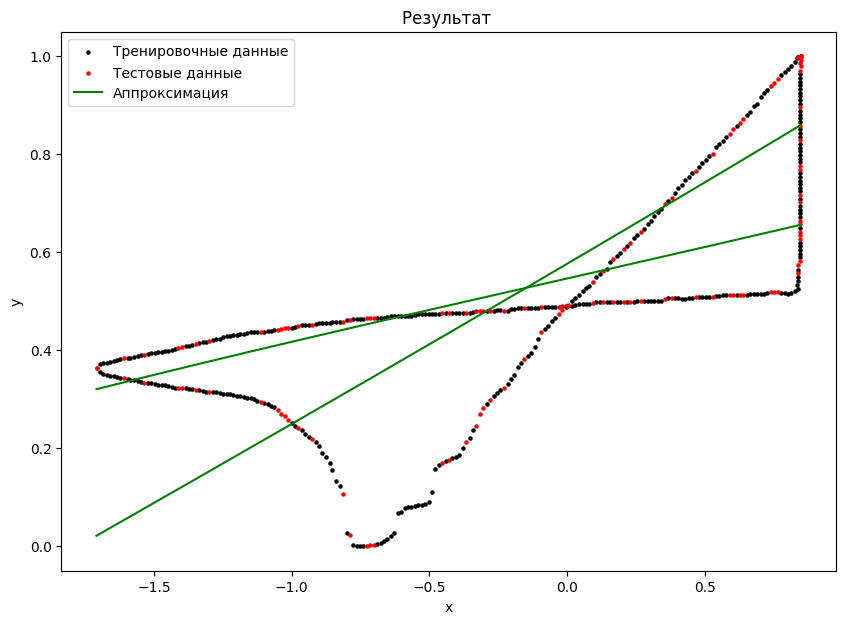

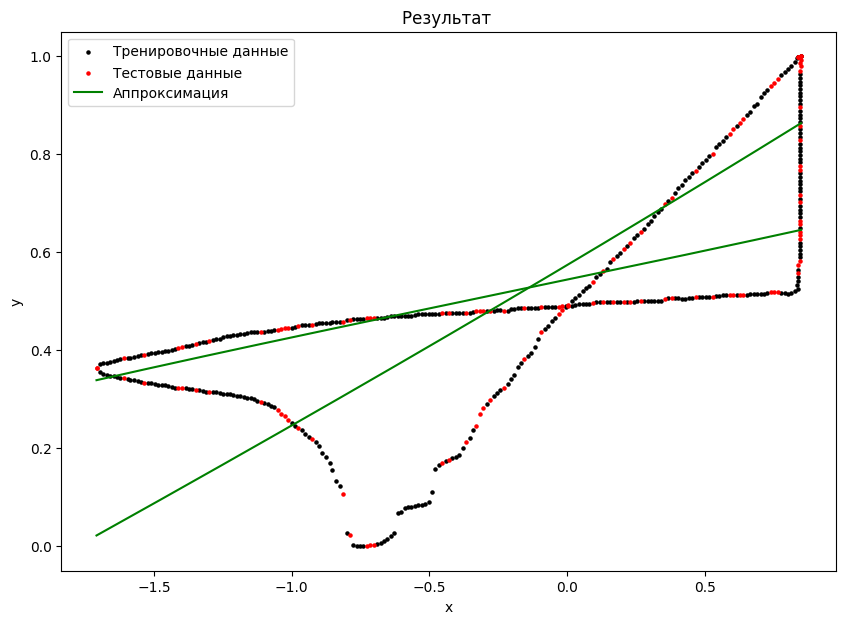

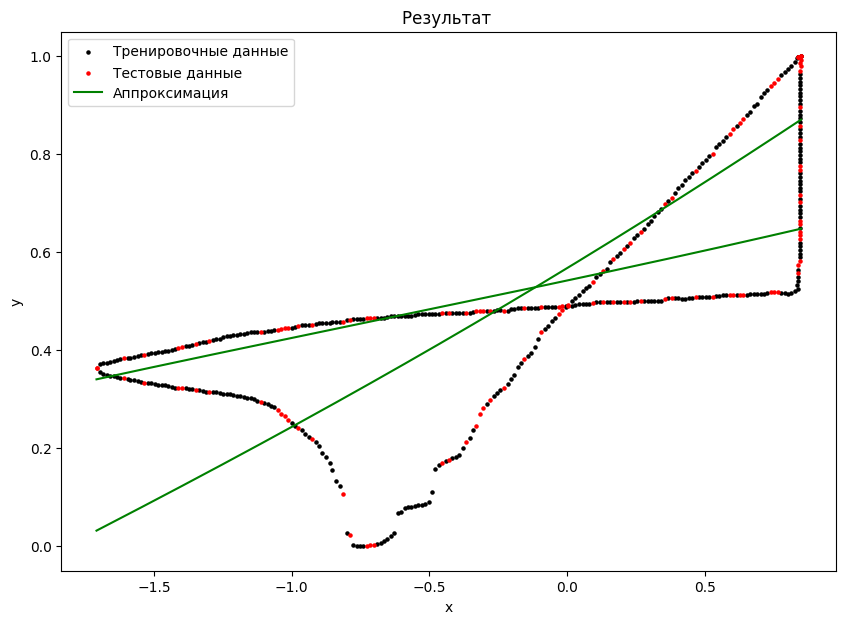

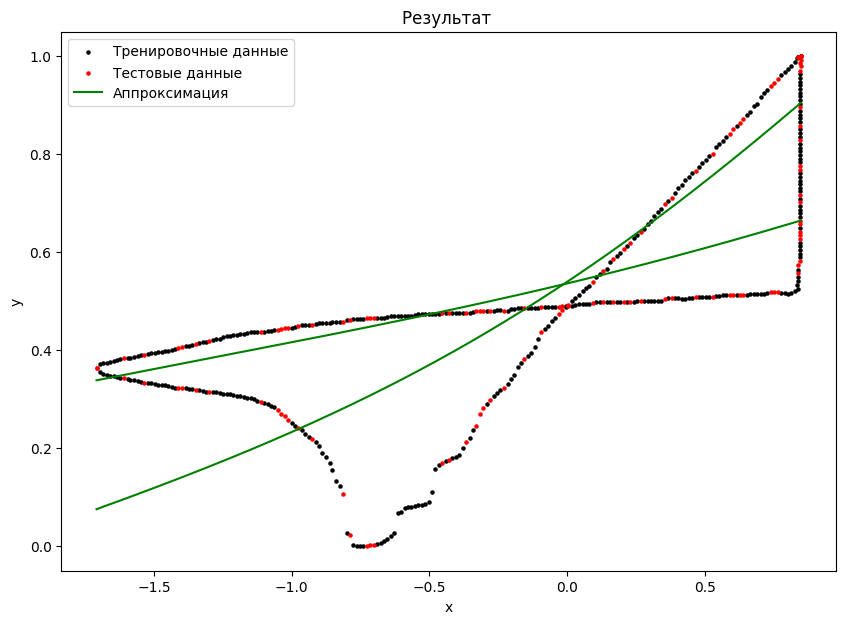

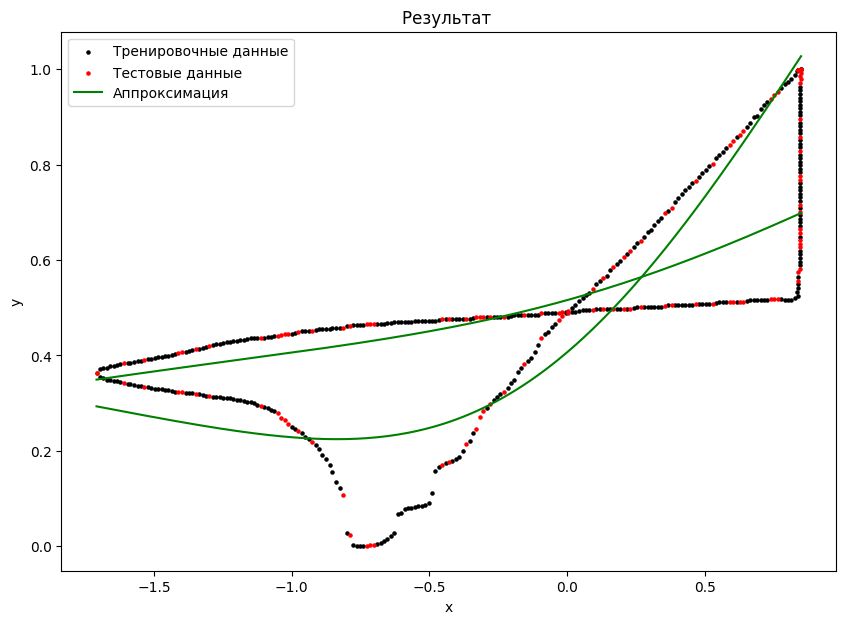

...

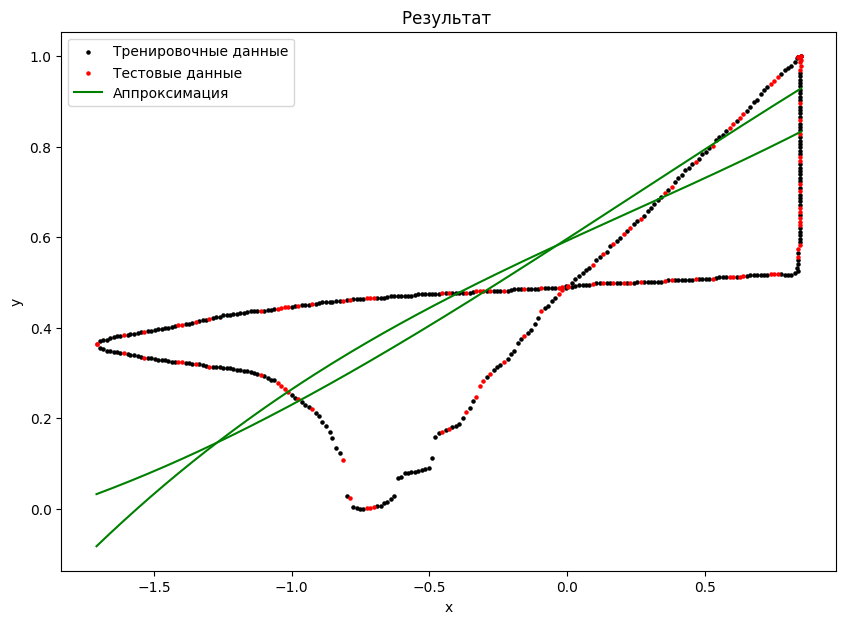

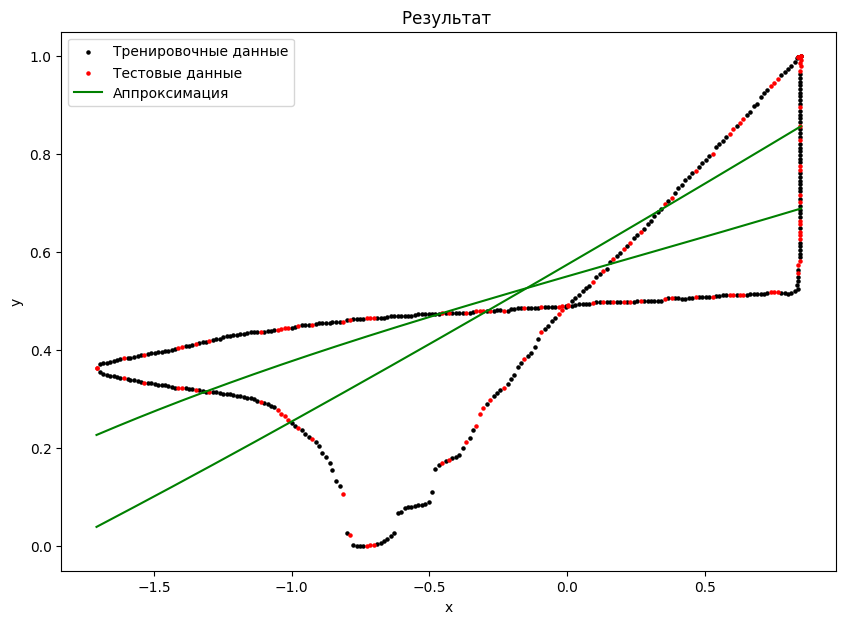

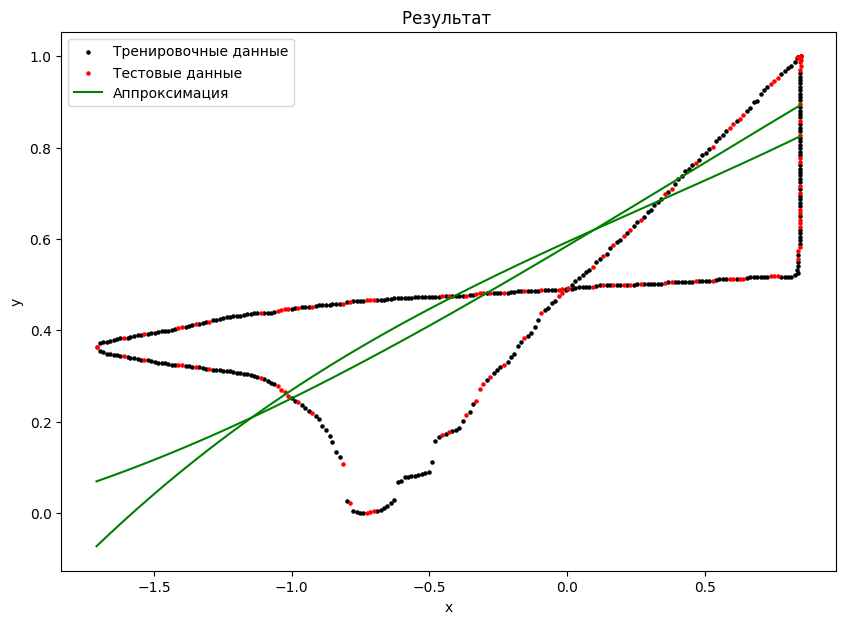

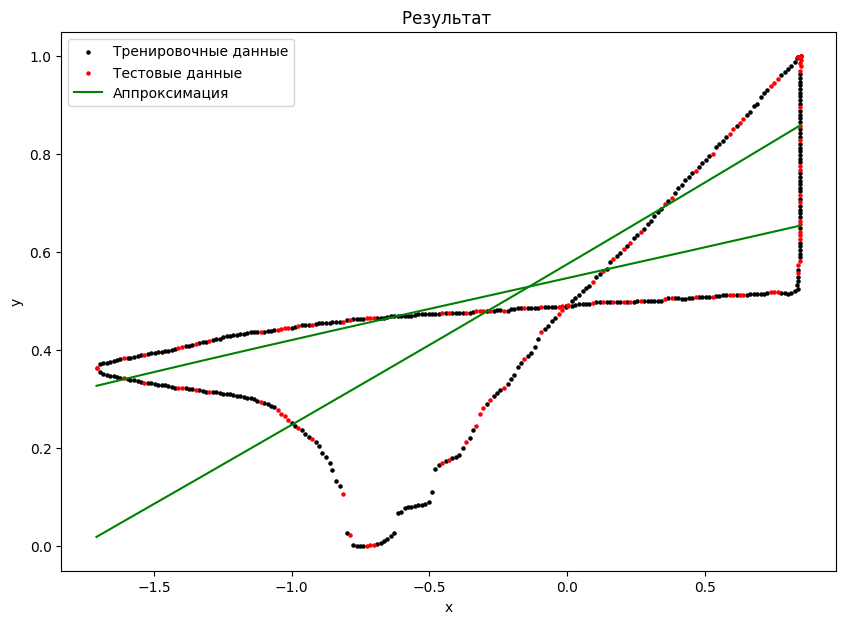

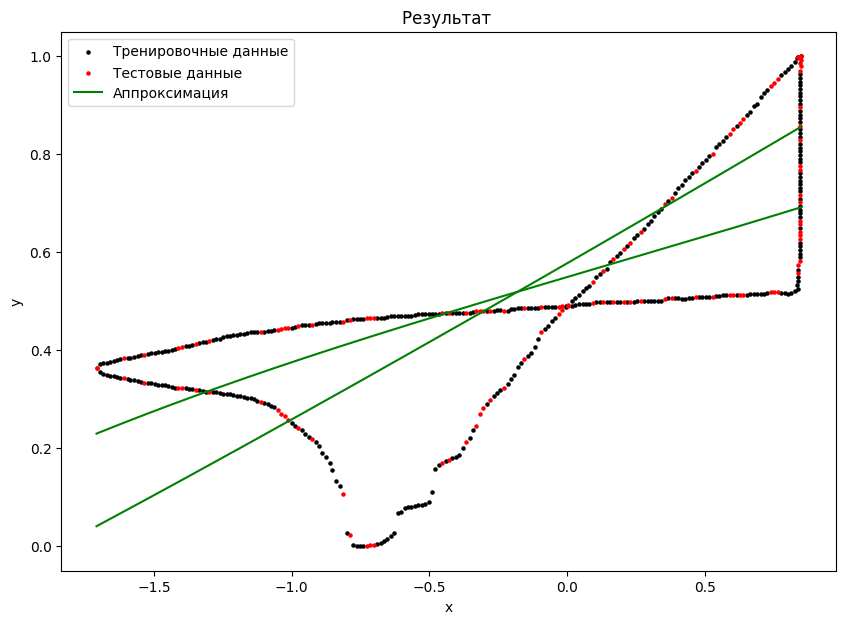

In [14]:
wandb.agent(sweep_id, train, count=30)